Nou còdec: lz4

Còdecs: blosclz, zstd, zlib i lz4
    
CONCLUSIONS: blosclz i lz4 es solapen un poc. Problema: de lz4 sols prediu bé un 6%

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import aux_funcs

In [2]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [3]:
ficheros = ['entropy-shuffle', 'blosclz-shuffle-split', 'zstd-shuffle-split', 'zlib-shuffle-split', 
           'lz4-shuffle-split']
categories = ["30", "0", "1", "2", "3"]

dataframes1 = {}
for i in range(len(ficheros)):
    dataframes1[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [4]:
path = Path('../data_inputs')

dataframes2 = {}
for i in range(len(ficheros)):
    dataframes2[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [5]:
path = Path('../data_inputs_wind/')

dataframes3 = {}
for i in range(len(ficheros)):
    dataframes3[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [6]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
1,2.02,2.340000e+09,0,0,-1,entropy-shuffle,30
2,5.73,5.700000e+09,0,0,-1,entropy-shuffle,30
3,13100.00,5.410000e+09,1,0,-1,entropy-shuffle,30
4,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,3
55292,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,3
55293,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,3
55294,16400.00,5.600000e+09,1,215,4,lz4-shuffle-split,3


In [7]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [8]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: blosclz


1: zstd

2: zlib

3: lz4

# DATAFRAME FILTRE shuffle

In [9]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [10]:
df_blosclz = pd.DataFrame()
df_blosclz = pd.concat([df_blosclz, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_blosclz.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_blosclz = df_blosclz.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [11]:
df_zstd = pd.DataFrame()
df_zstd = pd.concat([df_zstd, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_zstd.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_zstd = df_zstd.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [12]:
df_zlib = pd.DataFrame()
df_zlib = pd.concat([df_zlib, dataframes1[ficheros[3]], dataframes2[ficheros[3]], 
                        dataframes3[ficheros[3]]], axis = 0)

df_zlib.rename(columns = {'cratio':'cratio2', 'speed':'speed2', 'special_vals':'special_vals2'}, inplace = True)
df_zlib = df_zlib.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [13]:
df_lz4 = pd.DataFrame()
df_lz4 = pd.concat([df_lz4, dataframes1[ficheros[4]], dataframes2[ficheros[4]], 
                        dataframes3[ficheros[4]]], axis = 0)

df_lz4.rename(columns = {'cratio':'cratio3', 'speed':'speed3', 'special_vals':'special_vals3'}, inplace = True)
df_lz4 = df_lz4.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [14]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_blosclz, df_zstd, df_zlib, df_lz4, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio2,speed2,special_vals2,cratio3,speed3,special_vals3,cratio31,speed31,special_vals31
0,16400.00,5.210000e+09,1,16400.0,5.520000e+09,1,16400.00,5.390000e+09,1,16400.00,5.540000e+09,1,16400.00,5.410000e+09,1
1,2.28,1.700000e+08,0,4.9,6.950000e+06,0,4.78,2.470000e+07,0,1.96,1.740000e+08,0,2.02,2.340000e+09,0
2,5.76,4.090000e+08,0,17.1,1.850000e+07,0,14.80,4.230000e+07,0,4.94,3.590000e+08,0,5.73,5.700000e+09,0
3,13100.00,5.210000e+09,1,13100.0,5.520000e+09,1,13100.00,5.520000e+09,1,13100.00,5.560000e+09,1,13100.00,5.410000e+09,1
4,16400.00,5.230000e+09,1,16400.0,5.540000e+09,1,16400.00,5.540000e+09,1,16400.00,5.580000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.580000e+09,1,16400.0,5.580000e+09,1,16400.00,5.580000e+09,1,16400.00,5.560000e+09,1,16400.00,5.410000e+09,1
55292,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.520000e+09,1,16400.00,5.560000e+09,1,16400.00,5.310000e+09,1
55293,16400.00,5.580000e+09,1,16400.0,5.440000e+09,1,16400.00,5.580000e+09,1,16400.00,5.560000e+09,1,16400.00,5.540000e+09,1
55294,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.480000e+09,1,16400.00,5.600000e+09,1,16400.00,5.580000e+09,1


Eliminar special_value (que lo sea en alguna de las 4 categorías)

In [15]:
df_shuffle = aux_funcs.delete_special_vals(df_shuffle, ["special_vals0", "special_vals1", "special_vals2", "special_vals3", "special_vals31"])

In [16]:
df_input_x = df_shuffle.iloc[:, [12, 13]]

In [17]:
df_input_x

,cratio31,speed31
1,2.02,2.340000e+09
2,5.73,5.700000e+09
5,2.11,2.700000e+09
6,6.10,6.340000e+09
9,2.23,2.710000e+09
...,...,...
55203,21.80,1.440000e+10
55206,3.70,4.770000e+09
55207,19.00,1.380000e+10
55210,3.99,5.190000e+09


Cálculo del SCORE

In [18]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1', 'special_vals2', 'special_vals3'], axis = 1)

In [19]:
df_shuffle

,cratio0,speed0,cratio1,speed1,cratio2,speed2,cratio3,speed3
1,2.28,1.700000e+08,4.90,6950000.0,4.78,24700000.0,1.96,1.740000e+08
2,5.76,4.090000e+08,17.10,18500000.0,14.80,42300000.0,4.94,3.590000e+08
5,2.29,1.760000e+08,4.95,7130000.0,4.87,25300000.0,1.96,1.750000e+08
6,5.81,4.310000e+08,18.20,19600000.0,16.20,45400000.0,5.01,3.690000e+08
9,2.35,1.840000e+08,5.17,7130000.0,5.14,25300000.0,2.00,1.800000e+08
...,...,...,...,...,...,...,...,...
55203,48.70,2.400000e+09,152.00,64000000.0,111.00,117000000.0,44.40,1.770000e+09
55206,6.33,4.540000e+08,13.30,25300000.0,12.80,74100000.0,7.32,4.940000e+08
55207,50.20,2.460000e+09,148.00,62000000.0,110.00,121000000.0,43.50,1.770000e+09
55210,14.30,9.870000e+08,29.90,61200000.0,27.50,114000000.0,16.10,9.040000e+08


In [20]:
dfcratios = pd.DataFrame()
for i in range(0, 4):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [21]:
desv_cratio = dfcratios.std()[0]
desv_cratio

182.18033751791074

In [22]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

41.05630898299646

In [23]:
dfspeeds = pd.DataFrame()
for i in range(0, 4):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [24]:
mean_speed = dfspeeds.mean()[0]
mean_speed

423521591.8190568

In [25]:
desv_speed = dfspeeds.std()[0]
desv_speed

843661152.966881

In [26]:
theta = 0.89

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

cratio2 = df_shuffle["cratio2"]
speed2 = df_shuffle["speed2"]
ncratio2 = (cratio2 - mean_cratio) / desv_cratio
nspeed2 = (speed2 - mean_speed) / desv_speed
df_shuffle.insert(8, 2, theta*ncratio2 + (1-theta)*nspeed2)

cratio3 = df_shuffle["cratio3"]
speed3 = df_shuffle["speed3"]
ncratio3 = (cratio3 - mean_cratio) / desv_cratio
nspeed3 = (speed3 - mean_speed) / desv_speed
df_shuffle.insert(11, 3, theta*ncratio3 + (1-theta)*nspeed3)

In [27]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1,cratio2,speed2,2,cratio3,speed3,3
1,2.28,1.700000e+08,-0.222488,4.90,6950000.0,-0.230948,4.78,24700000.0,-0.229220,1.96,1.740000e+08,-0.223530
2,5.76,4.090000e+08,-0.174325,17.10,18500000.0,-0.169841,14.80,42300000.0,-0.177974,4.94,3.590000e+08,-0.184850
5,2.29,1.760000e+08,-0.221657,4.95,7130000.0,-0.230680,4.87,25300000.0,-0.228702,1.96,1.750000e+08,-0.223399
6,5.81,4.310000e+08,-0.171213,18.20,19600000.0,-0.164324,16.20,45400000.0,-0.170731,5.01,3.690000e+08,-0.183205
9,2.35,1.840000e+08,-0.220321,5.17,7130000.0,-0.229605,5.14,25300000.0,-0.227383,2.00,1.800000e+08,-0.222552
...,...,...,...,...,...,...,...,...,...,...,...,...
55203,48.70,2.400000e+09,0.295043,152.00,64000000.0,0.495114,111.00,117000000.0,0.301728,44.40,1.770000e+09,0.191894
55206,6.33,4.540000e+08,-0.165673,13.30,25300000.0,-0.187519,12.80,74100000.0,-0.183599,7.32,4.940000e+08,-0.155622
55207,50.20,2.460000e+09,0.310194,148.00,62000000.0,0.475312,110.00,121000000.0,0.297364,43.50,1.770000e+09,0.187497
55210,14.30,9.870000e+08,-0.057243,29.90,61200000.0,-0.101743,27.50,114000000.0,-0.106583,16.10,9.040000e+08,-0.059272


In [28]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1', 'cratio2', 'speed2', 'cratio3', 'speed3'], axis = 1)

In [29]:
df_pos

,0,1,2,3
1,-0.222488,-0.230948,-0.229220,-0.223530
2,-0.174325,-0.169841,-0.177974,-0.184850
5,-0.221657,-0.230680,-0.228702,-0.223399
6,-0.171213,-0.164324,-0.170731,-0.183205
9,-0.220321,-0.229605,-0.227383,-0.222552
...,...,...,...,...
55203,0.295043,0.495114,0.301728,0.191894
55206,-0.165673,-0.187519,-0.183599,-0.155622
55207,0.310194,0.475312,0.297364,0.187497
55210,-0.057243,-0.101743,-0.106583,-0.059272


EJERCICIO TOIA

In [30]:
col = df_pos.iloc[:, 0]
df = col.to_frame(name='punct')
df

df_0 = pd.DataFrame()
df_0 = pd.concat([df_0, df], axis = 0)
categoria = np.repeat(str(0), 77925)
df_0['categoria'] = categoria
df_0

,punct,categoria
1,-0.222488,0
2,-0.174325,0
5,-0.221657,0
6,-0.171213,0
9,-0.220321,0
...,...,...
55203,0.295043,0
55206,-0.165673,0
55207,0.310194,0
55210,-0.057243,0


In [31]:
col = df_pos.iloc[:, 1]
df = col.to_frame(name='punct')
df

df_1 = pd.DataFrame()
df_1 = pd.concat([df_1, df], axis = 0)
categoria = np.repeat('1', 77925)
df_1['categoria'] = categoria
df_1

,punct,categoria
1,-0.230948,1
2,-0.169841,1
5,-0.230680,1
6,-0.164324,1
9,-0.229605,1
...,...,...
55203,0.495114,1
55206,-0.187519,1
55207,0.475312,1
55210,-0.101743,1


In [32]:
df_fig = pd.DataFrame()
df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
df_fig

,punct,categoria
1,-0.222488,0
2,-0.174325,0
5,-0.221657,0
6,-0.171213,0
9,-0.220321,0
...,...,...
55203,0.495114,1
55206,-0.187519,1
55207,0.475312,1
55210,-0.101743,1


In [33]:
fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
fig.show()

FIN EJERCICIO

In [34]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
1,0
2,1
5,0
6,1
9,0
...,...
55203,1
55206,3
55207,1
55210,0


In [35]:
categorias = best_categ_shuffle['best_categ'].unique()

In [36]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 43864],
       [    1, 20143],
       [    2,  5962],
       [    3,  7956]])

In [37]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,0
2,5.73,5.700000e+09,1
5,2.11,2.700000e+09,0
6,6.10,6.340000e+09,1
9,2.23,2.710000e+09,0
...,...,...,...
55203,21.80,1.440000e+10,1
55206,3.70,4.770000e+09,3
55207,19.00,1.380000e+10,1
55210,3.99,5.190000e+09,0


Balancear

In [38]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=5962)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,0
5,2.11,2.700000e+09,0
9,2.23,2.710000e+09,0
13,2.37,2.810000e+09,0
17,1.29,1.990000e+09,0
...,...,...,...
22875,3.34,4.050000e+09,3
22883,5.53,6.140000e+09,3
22891,3.31,4.120000e+09,3
22903,44.30,1.870000e+10,3


In [39]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(23848, 1)

In [40]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(23848, 2)

Normalizar inputs

In [41]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [42]:
desv_cratio = dfcratios.std()[0]
desv_cratio

30.51360823317033

In [43]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

11.87477608185173

In [44]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [45]:
mean_speed = dfspeeds.mean()[0]
mean_speed

5594690833.612882

In [46]:
desv_speed = dfspeeds.std()[0]
desv_speed

3827595780.7470207

In [47]:
dfinput_x

,cratio31,speed31
1,2.02,2.340000e+09
5,2.11,2.700000e+09
9,2.23,2.710000e+09
13,2.37,2.810000e+09
17,1.29,1.990000e+09
...,...,...
22875,3.34,4.050000e+09
22883,5.53,6.140000e+09
22891,3.31,4.120000e+09
22903,44.30,1.870000e+10


In [48]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [49]:
dfinput_x_norm

,ncratio,nspeed
1,-0.322963,-0.850323
5,-0.320014,-0.756269
9,-0.316081,-0.753656
13,-0.311493,-0.727530
17,-0.346887,-0.941764
...,...,...
22875,-0.279704,-0.403567
22883,-0.207933,0.142468
22891,-0.280687,-0.385279
22903,1.062648,3.423901


In [50]:
dfinput_x = dfinput_x_norm

In [51]:
dfinput_y

,best_categ
1,0
5,0
9,0
13,0
17,0
...,...
22875,3
22883,3
22891,3
22903,3


In [52]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [53]:
dfinput_y

,best_categ
1,0
5,0
9,0
13,0
17,0
...,...
22875,3
22883,3
22891,3
22903,3


In [54]:
dfinput_x.shape

(23848, 2)

In [55]:
dfinput_y.shape

(23848, 1)

# RED NEURONAL (2 categorías)

In [56]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

2022-12-28 12:20:15.755697: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [57]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(25, activation='relu'))
model.add(layers.Dense(4, activation='softmax'))

2022-12-28 12:20:20.681551: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [58]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [59]:
history = model.fit(dfinput_x, dfinput_y, epochs=30, validation_split=0.1)

Epoch 1/30
671/671 [==============================] - 2s 2ms/step - loss: 1.1556 - acc: 0.4810 - val_loss: 1.9755 - val_acc: 0.0000e+00
Epoch 2/30
671/671 [==============================] - 1s 2ms/step - loss: 1.0484 - acc: 0.5190 - val_loss: 2.1108 - val_acc: 0.0000e+00
Epoch 3/30
671/671 [==============================] - 1s 2ms/step - loss: 1.0415 - acc: 0.5243 - val_loss: 2.1850 - val_acc: 0.0000e+00
Epoch 4/30
671/671 [==============================] - 2s 2ms/step - loss: 1.0367 - acc: 0.5276 - val_loss: 2.0468 - val_acc: 0.0000e+00
Epoch 5/30
671/671 [==============================] - 2s 3ms/step - loss: 1.0339 - acc: 0.5297 - val_loss: 2.1184 - val_acc: 0.0000e+00
Epoch 6/30
671/671 [==============================] - 2s 3ms/step - loss: 1.0317 - acc: 0.5304 - val_loss: 2.0613 - val_acc: 0.0000e+00
Epoch 7/30
671/671 [==============================] - 2s 3ms/step - loss: 1.0301 - acc: 0.5313 - val_loss: 2.1148 - val_acc: 0.0000e+00
Epoch 8/30
671/671 [============================

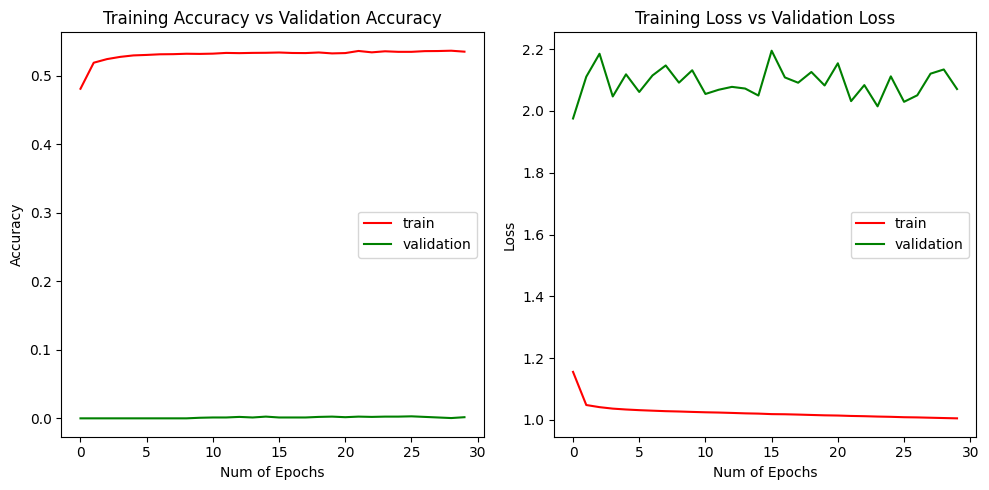

In [60]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [61]:
y_hat = model.predict(x=dfinput_x)
y_hat

746/746 [==============================] - 1s 1ms/step


array([[0.66857266, 0.0027237 , 0.02567775, 0.30302584],
       [0.65195584, 0.01010315, 0.06894843, 0.2689926 ],
       [0.6396462 , 0.01271479, 0.08182803, 0.26581106],
       ...,
       [0.15244365, 0.22832336, 0.47173834, 0.1474946 ],
       [0.07711631, 0.5705481 , 0.31137612, 0.04095942],
       [0.6393567 , 0.00128357, 0.01449621, 0.34486344]], dtype=float32)

In [62]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y, axis = 1)

In [63]:
y_pred_label

array([0, 0, 0, ..., 2, 1, 0])

In [64]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[   0, 8094],
       [   1, 8587],
       [   2, 7145],
       [   3,   22]])

In [65]:
y_true_label

array([0, 0, 0, ..., 3, 3, 3])

In [66]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[   0, 5962],
       [   1, 5962],
       [   2, 5962],
       [   3, 5962]])

In [67]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla


col_0,0,1,2,3
row_0,,,,
0,4439,75,410,3170
1,668,4245,2723,951
2,844,1642,2828,1831
3,11,0,1,10
